In [1]:
from PIL import Image, ImageDraw, ImageFont
from os import listdir
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
import os
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
from keras.utils import np_utils
from keras import backend as K
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.python import keras
from keras.layers import Dense, Flatten, Conv2D, Dropout, MaxPooling2D, BatchNormalization,Input
from keras.models import Model,load_model
from IPython.display import SVG
from keras.callbacks import EarlyStopping,ModelCheckpoint
from keras.utils.vis_utils import model_to_dot
from tensorflow.keras.utils import plot_model
#%matplotlib inline
#print(os.listdir("../input/"))
#InputPath = "../input/artificial-lunar-rocky-landscape-dataset/images/"
# Any results you write to the current direct

In [2]:
fontsize = 50

# From https://www.google.com/get/noto/
!wget -q --show-progress https://noto-website-2.storage.googleapis.com/pkgs/NotoSansCJKjp-hinted.zip
!unzip -p NotoSansCJKjp-hinted.zip NotoSansCJKjp-Regular.otf > NotoSansCJKjp-Regular.otf
!rm NotoSansCJKjp-hinted.zip

font = ImageFont.truetype('./NotoSansCJKjp-Regular.otf', fontsize, encoding='utf-8')

NotoSansCJKjp-hinte 100%[===================>] 115.49M   150MB/s    in 0.8s    


In [3]:
df_train = pd.read_csv('/content/drive/MyDrive/Train/train.csv')
unicode_map = {codepoint: char for codepoint, char in pd.read_csv('/content/drive/MyDrive/Train/unicode_translation.csv').values}
unicode_map

{'U+0031': '1',
 'U+0032': '2',
 'U+0034': '4',
 'U+0036': '6',
 'U+0039': '9',
 'U+003F': '?',
 'U+2000B': '𠀋',
 'U+20D45': '𠵅',
 'U+2123D': '𡈽',
 'U+22999': '𢦙',
 'U+22CE3': '𢳣',
 'U+231C3': '𣇃',
 'U+2324A': '𣉊',
 'U+233D0': '𣏐',
 'U+23D0E': '𣴎',
 'U+241C6': '𤇆',
 'U+242CE': '𤋎',
 'U+2437D': '𤍽',
 'U+24E30': '𩹵',
 'U+24E60': '𤹠',
 'U+24FA3': '𤾣',
 'U+2564A': '𩹵',
 'U+25750': '𥝐',
 'U+25877': '𥡷',
 'U+25A0': '■',
 'U+25A1': '□',
 'U+25B2': '▲',
 'U+25B3': '△',
 'U+25CB': '○',
 'U+25CF': '●',
 'U+25DA1': '𥶡',
 'U+25E2E': '𥸮',
 'U+25EF': '◯',
 'U+25FFB': '𥿻',
 'U+264B3': '𦒳',
 'U+266B0': '𦚰',
 'U+27752': '𧝒',
 'U+28263': '𩹵',
 'U+29780': '𩞀',
 'U+29DDA': '𩷚',
 'U+29E75': '𩹵',
 'U+3002': '。',
 'U+3005': '々',
 'U+3006': '〆',
 'U+3007': '0',
 'U+300C': '「',
 'U+300D': '」',
 'U+3031': '〱',
 'U+3032': '〲',
 'U+303B': '〻',
 'U+303D': '〽',
 'U+3042': 'あ',
 'U+3044': 'い',
 'U+3046': 'う',
 'U+3048': 'え',
 'U+304A': 'お',
 'U+304B': 'か',
 'U+304C': 'が',
 'U+304D': 'き',
 'U+304E': 'ぎ',
 'U+304F': '

In [4]:
df_train.isnull().sum()

image_id    0
labels      0
dtype: int64

In [5]:
# This function takes in a filename of an image, and the labels in the string format given in train.csv, and returns an image containing the bounding boxes and characters annotated
def visualize_training_data(image_fn, labels):
    # Convert annotation string to array
    labels = np.array(labels.split(' ')).reshape(-1, 5)
    #print(labels)
    
    # Read image
    imsource = Image.open(image_fn).convert('RGBA')
    bbox_canvas = Image.new('RGBA', imsource.size)
    char_canvas = Image.new('RGBA', imsource.size)
    bbox_draw = ImageDraw.Draw(bbox_canvas) # Separate canvases for boxes and chars so a box doesn't cut off a character
    char_draw = ImageDraw.Draw(char_canvas)

    for codepoint, x, y, w, h in labels:
        x, y, w, h = int(x), int(y), int(w), int(h)
        char = unicode_map[codepoint] # Convert codepoint to actual unicode character

        # Draw bounding box around character, and unicode character next to it
        bbox_draw.rectangle((x, y, x+w, y+h), fill=(255, 255, 255, 0), outline=(255, 0, 0, 255))
        char_draw.text((x + w + fontsize/4, y + h/2 - fontsize), char, fill=(0, 0, 255, 255), font=font)
        Croped_image = imsource.crop((x, y, x+w, y+h))
        plt.figure()
        print(str(unicode_map[codepoint]))
        plt.imshow(Croped_image)
        plt.show()

    imsource = Image.alpha_composite(Image.alpha_composite(imsource, bbox_canvas), char_canvas)
    imsource = imsource.convert("RGB") # Remove alpha for saving in jpg format.
    return np.asarray(imsource)

In [9]:
!unzip /content/drive/MyDrive/Train/train_images.zip -d /content/drive/MyDrive/Train/Images

Archive:  /content/drive/MyDrive/Train/train_images.zip
  inflating: /content/drive/MyDrive/Train/Images/200021660-00082_1.jpg  
  inflating: /content/drive/MyDrive/Train/Images/200004148_00039_2.jpg  
  inflating: /content/drive/MyDrive/Train/Images/200021853-00006_2.jpg  
  inflating: /content/drive/MyDrive/Train/Images/umgy008-020.jpg  
  inflating: /content/drive/MyDrive/Train/Images/hnsd012-017.jpg  
  inflating: /content/drive/MyDrive/Train/Images/hnsd004-021.jpg  
  inflating: /content/drive/MyDrive/Train/Images/hnsd007-024.jpg  
  inflating: /content/drive/MyDrive/Train/Images/100249371_00028_1.jpg  
  inflating: /content/drive/MyDrive/Train/Images/umgy006-029.jpg  
  inflating: /content/drive/MyDrive/Train/Images/200021802-00017_1.jpg  
  inflating: /content/drive/MyDrive/Train/Images/100249376_00051_1.jpg  
  inflating: /content/drive/MyDrive/Train/Images/200021712-00008_1.jpg  
  inflating: /content/drive/MyDrive/Train/Images/hnsd009-027.jpg  
  inflating: /content/drive/MyD

ア


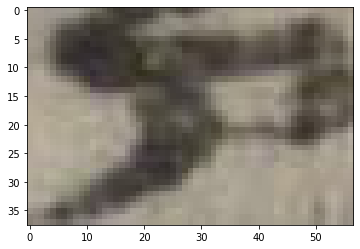

マ


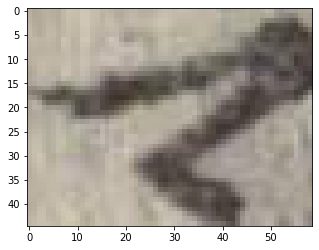

い


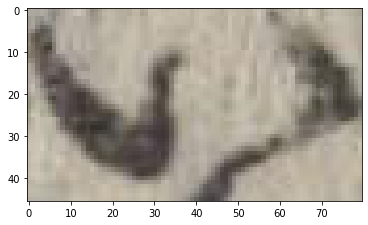

は


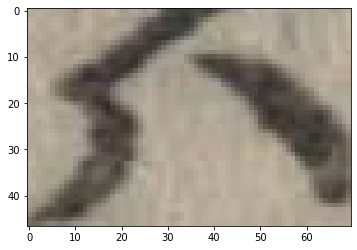

モ


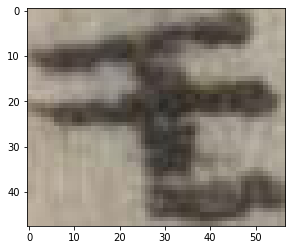

ヨ


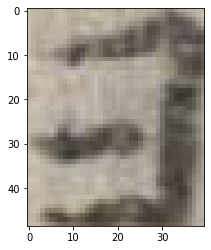

か


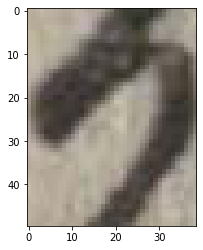

が


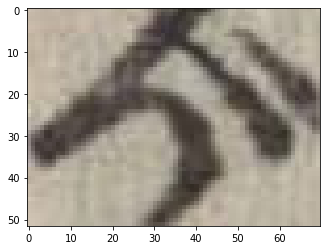

ツ


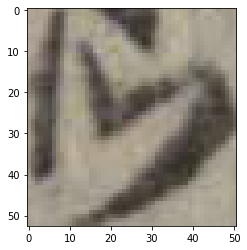

の


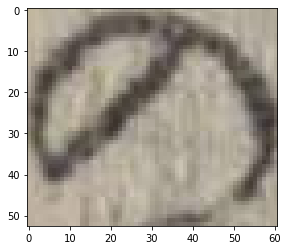

は


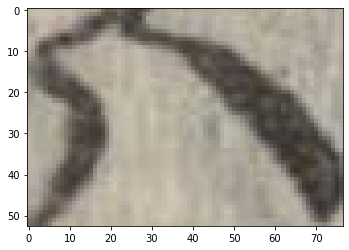

五


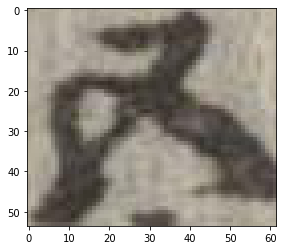

ふ


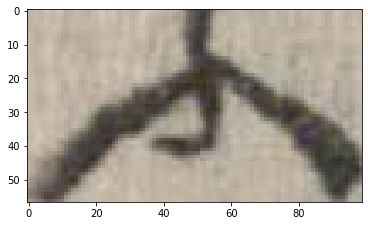

か


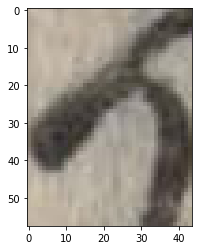

ゝ


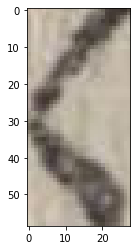

や


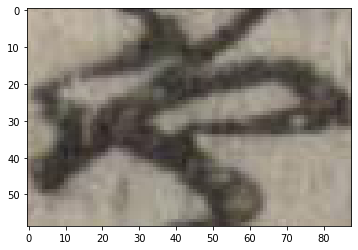

へ


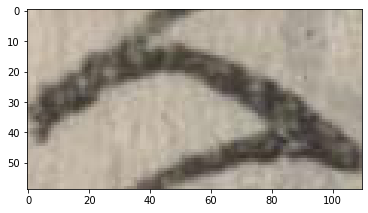

へ


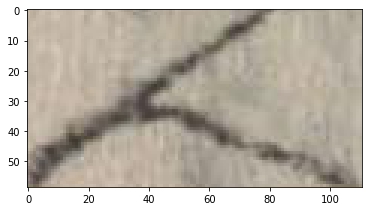

ウ


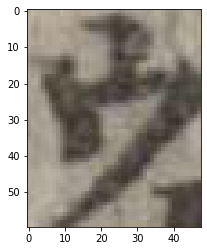

の


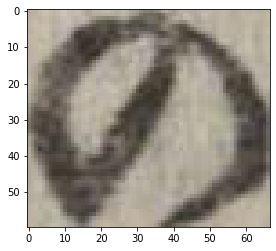

ア


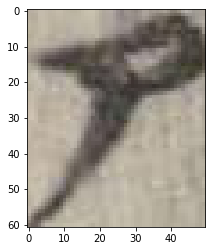

い


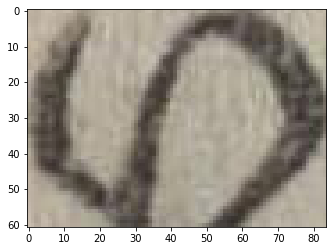

女


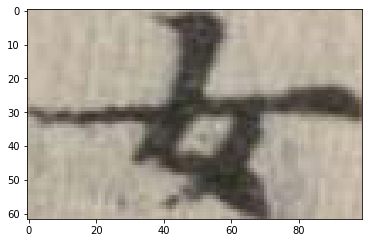

六


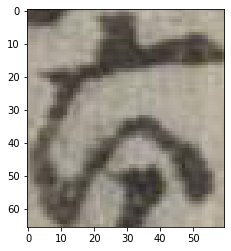

が


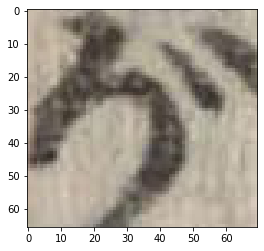

が


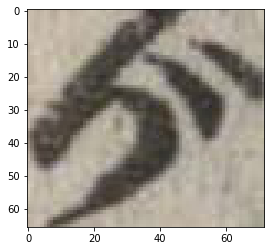

ふ


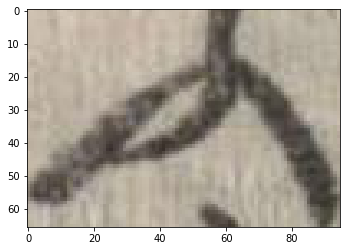

が


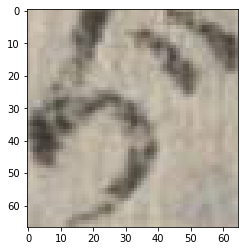

の


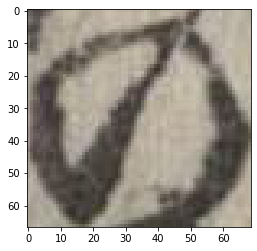

し


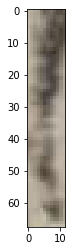

の


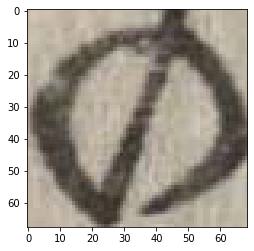

御


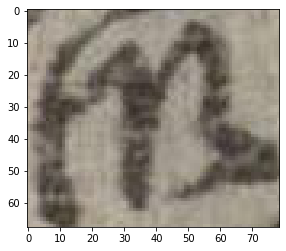

こ


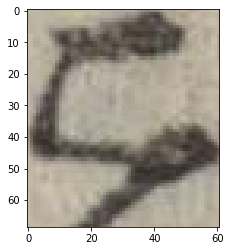

の


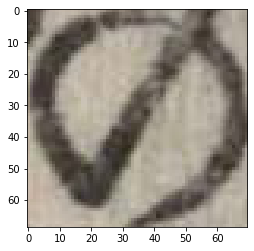

と


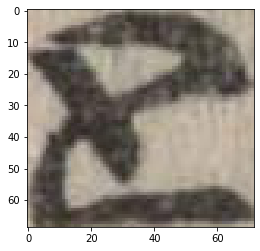

に


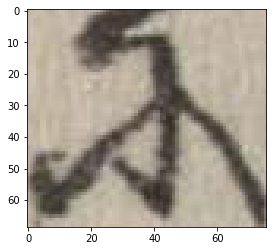

の


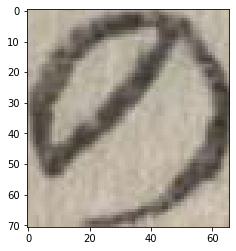

と


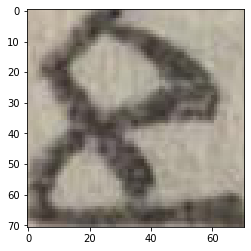

ア


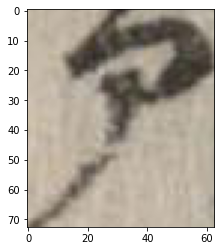

の


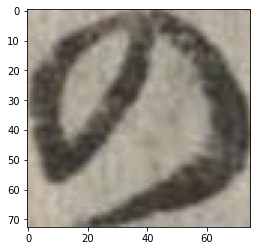

い


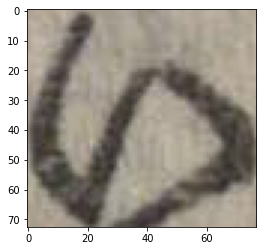

は


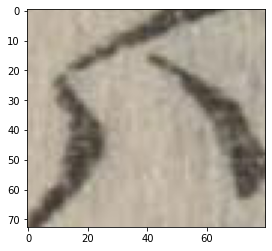

や


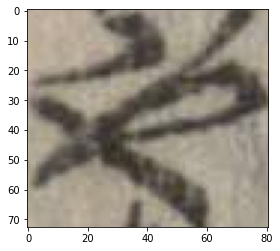

を


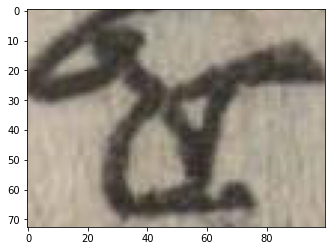

に


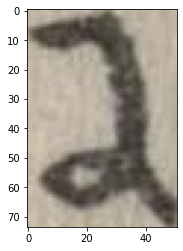

か


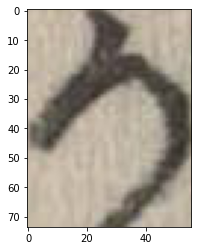

の


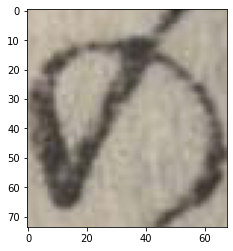

て


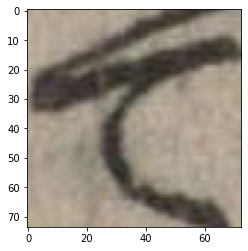

お


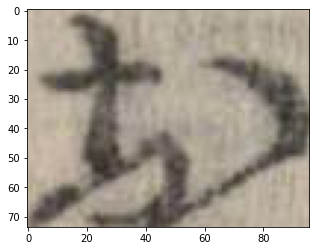

に


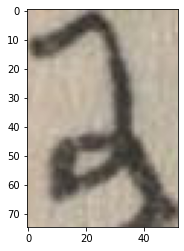

人


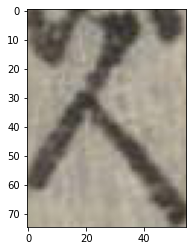

ア


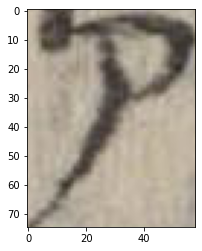

く


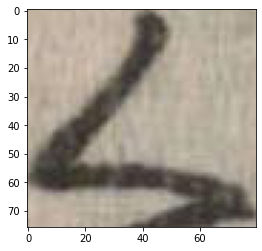

お


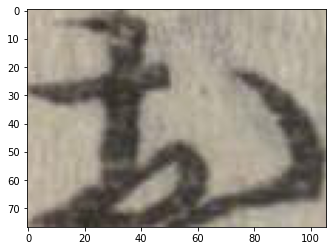

て


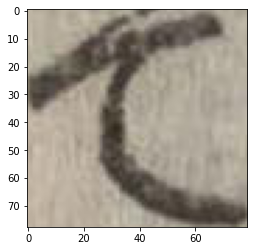

つ


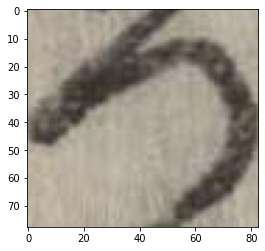

は


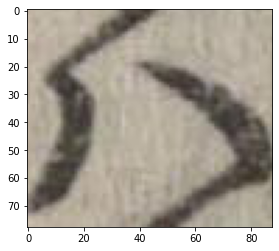

ん


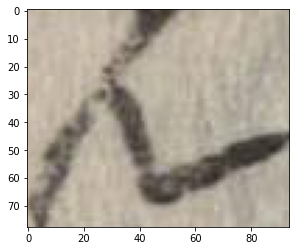

ふ


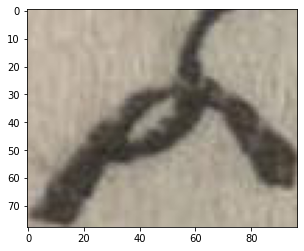

へ


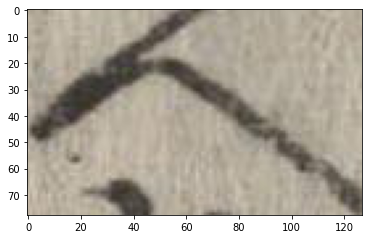

み


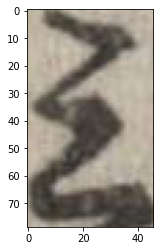

つ


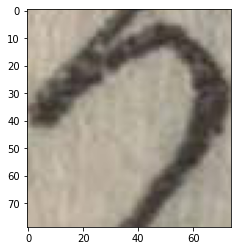

る


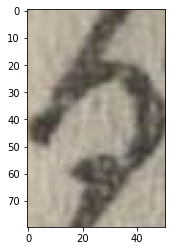

て


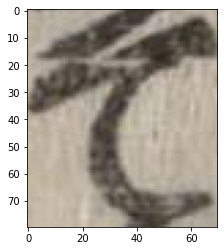

い


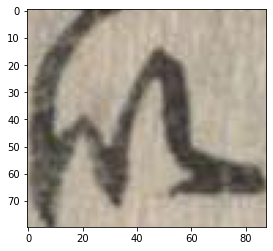

お


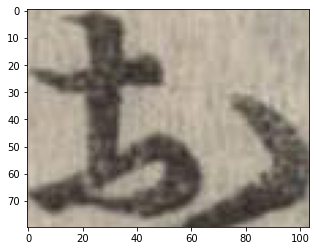

へ


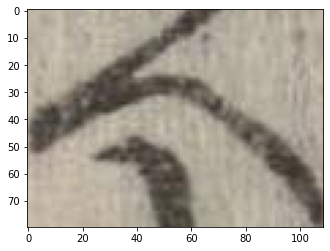

へ


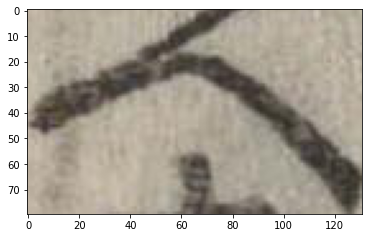

も


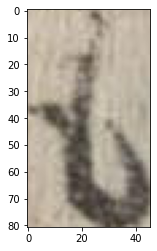

た


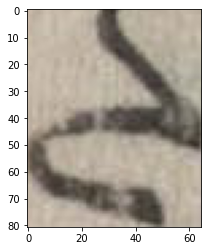

た


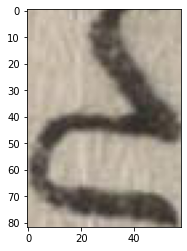

さ


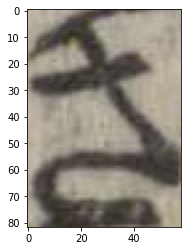

い


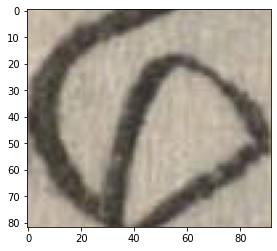

と


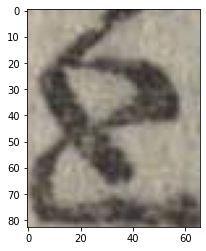

つ


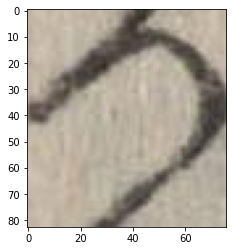

ぢ


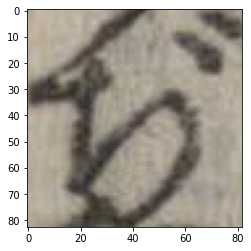

ん


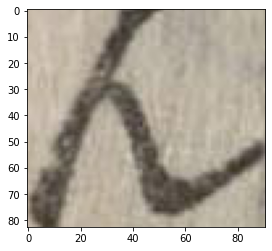

り


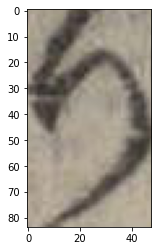

な


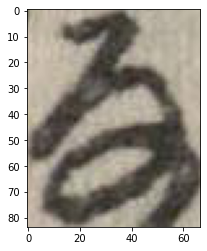

お


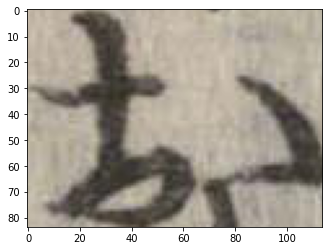

ち


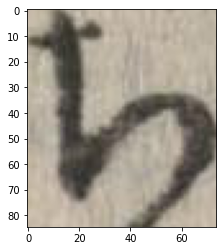

イ


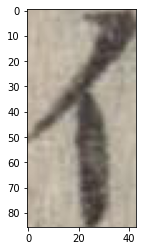

た


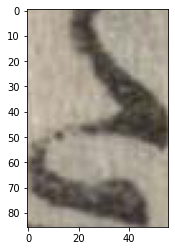

女


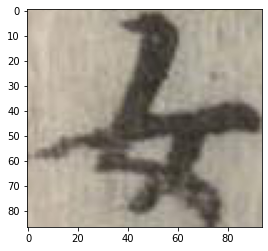

そ


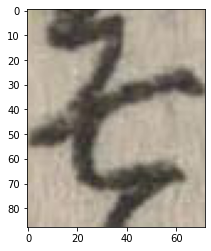

る


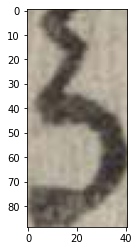

に


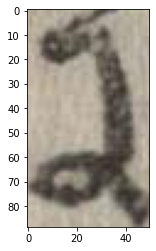

さ


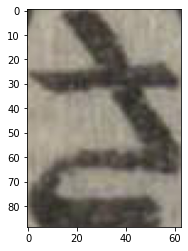

い


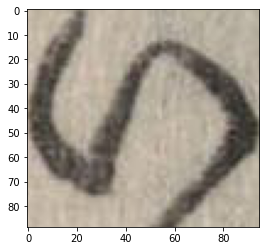

ら


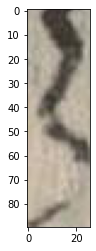

り


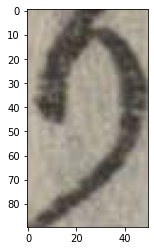

で


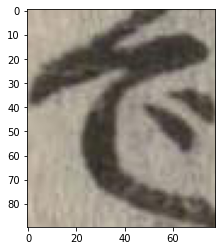

で


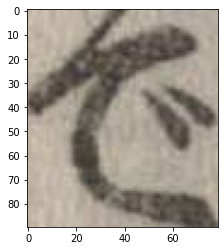

小


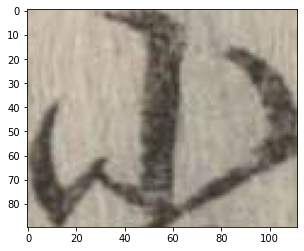

ち


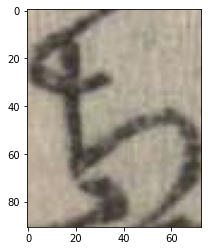

や


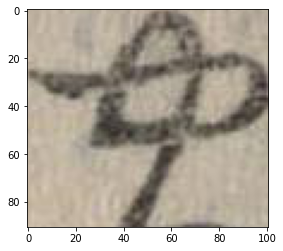

り


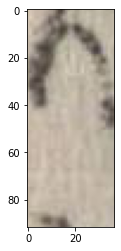

た


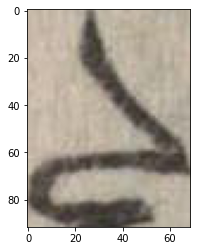

ず


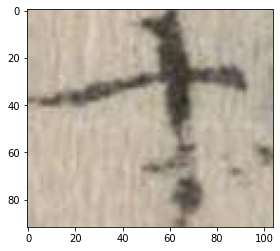

お


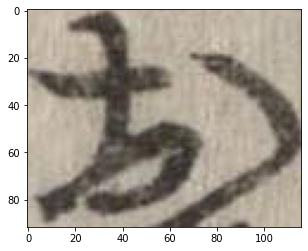

を


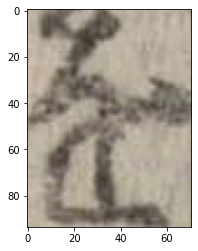

ぞ


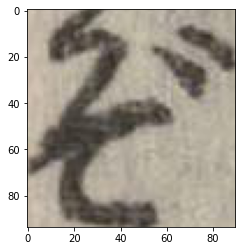

び


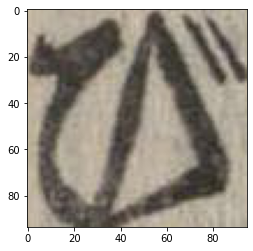

と


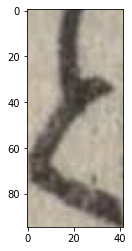

に


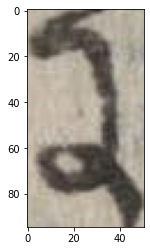

も


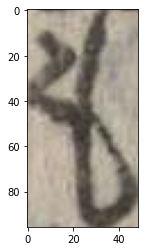

を


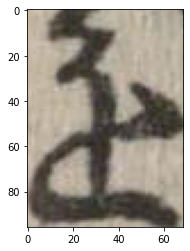

ほ


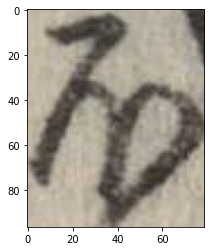

ね


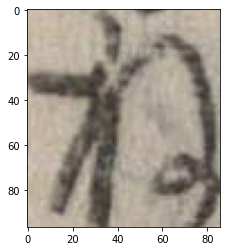

つ


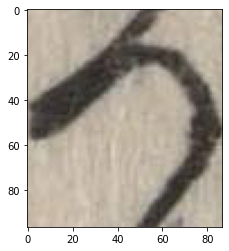

ま


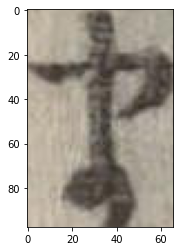

ま


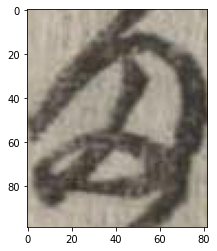

し


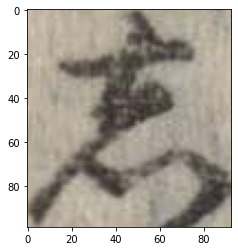

女


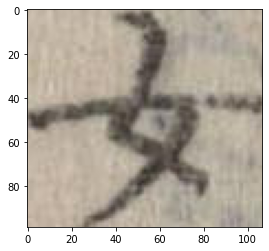

ら


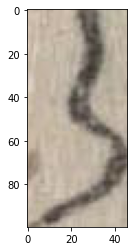

わ


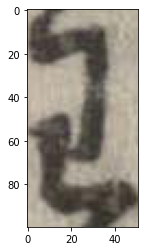

し


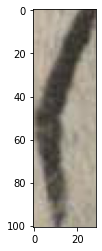

ら


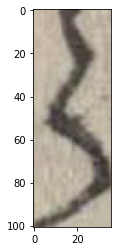

り


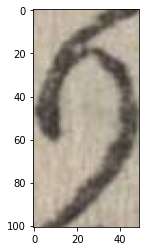

も


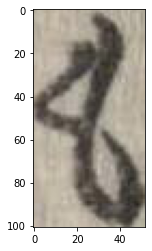

さ


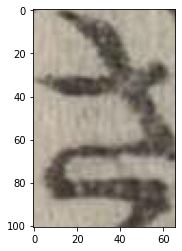

れ


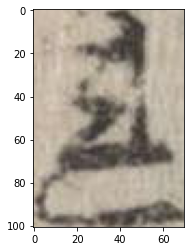

さ


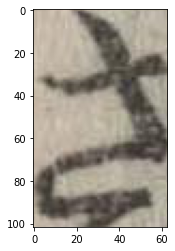

人


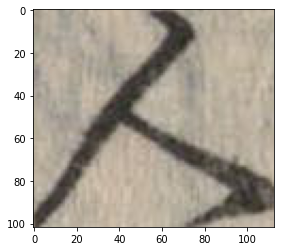

ま


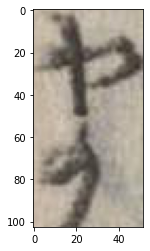

も


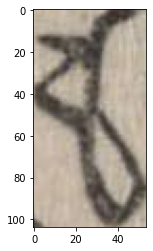

由


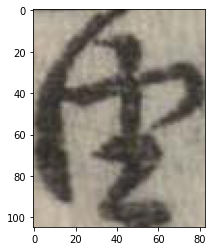

道


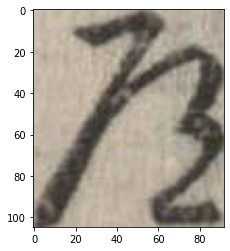

伊


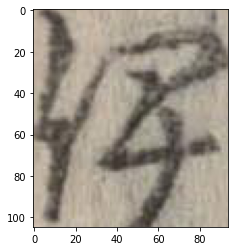

せ


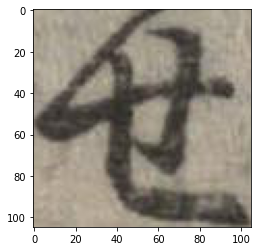

帰


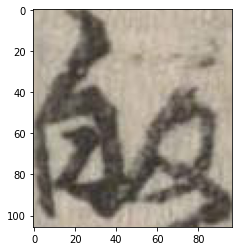

け


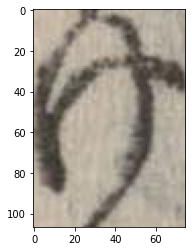

も


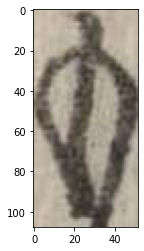

を


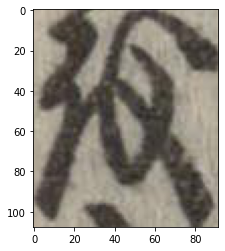

ん


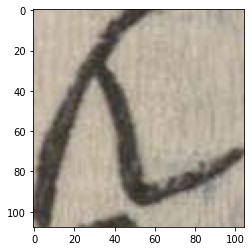

私


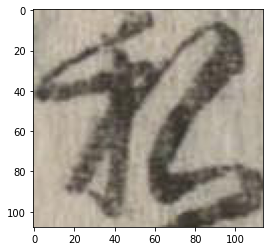

た


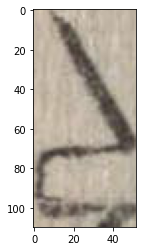

立


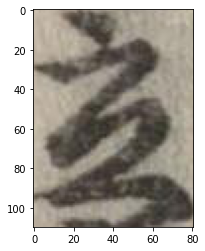

江


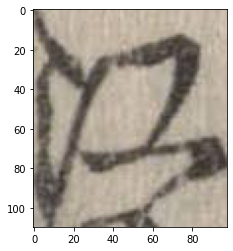

大


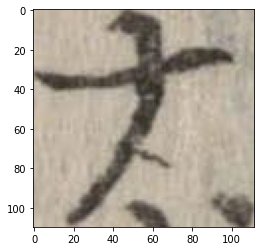

結


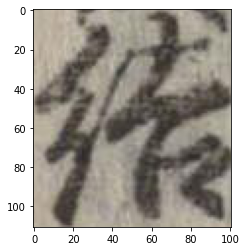

喰


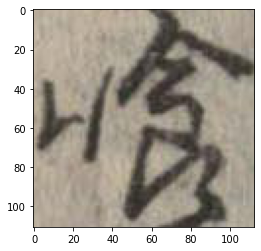

道


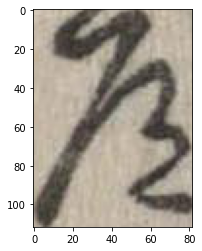

ね


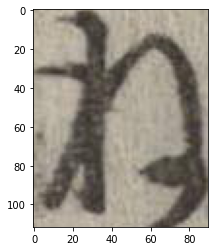

〱


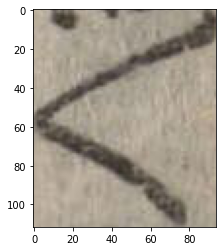

天


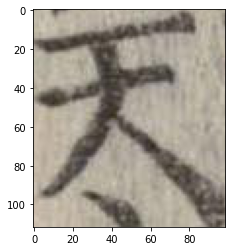

ち


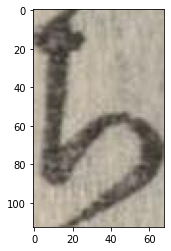

知


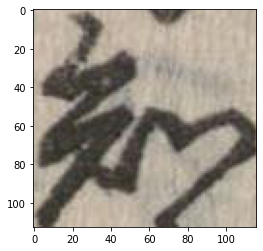

ば


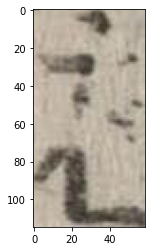

ら


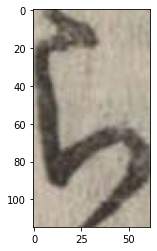

れ


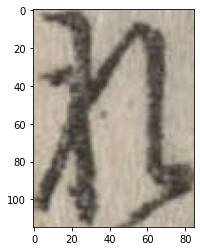

衆


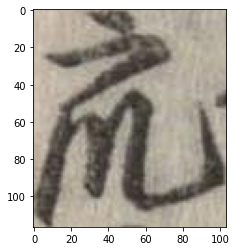

立


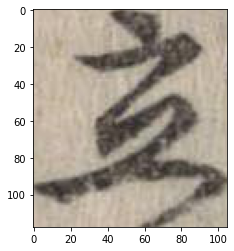

ら


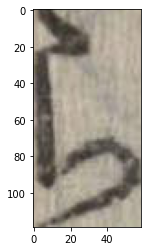

れ


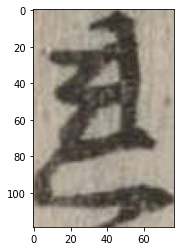

江


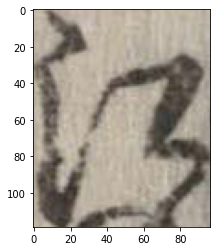

〱


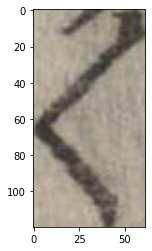

𠀋


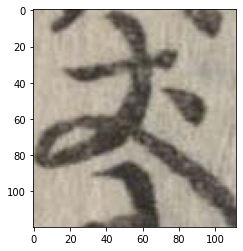

ま


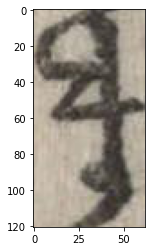

弁


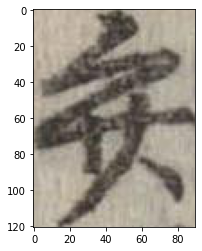

姉


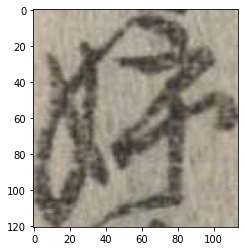

ま


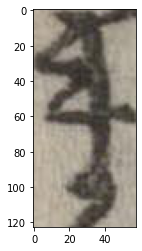

島


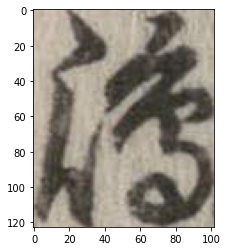

余


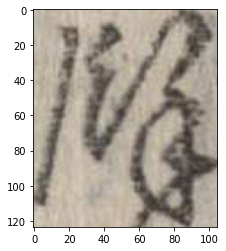

ら


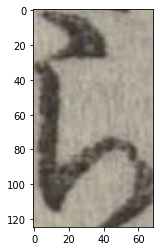

す


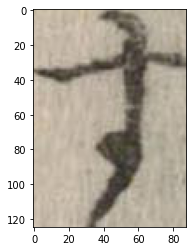

過


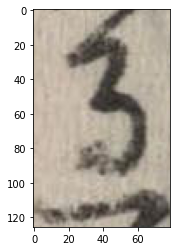

今


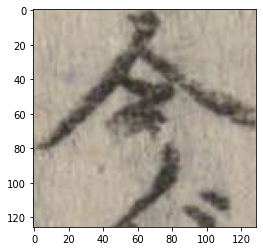

願


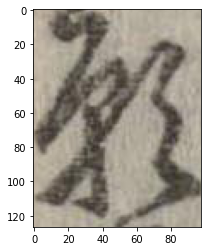

惚


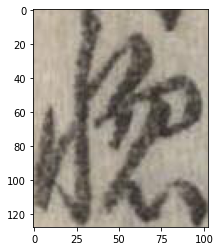

島


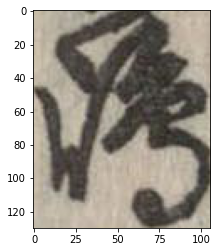

達


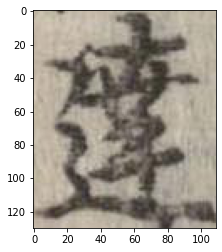

も


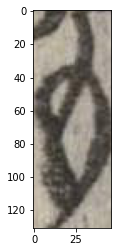

役


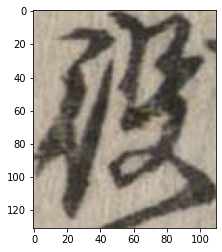

若


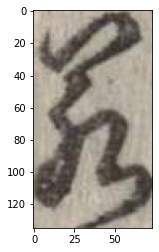

夫


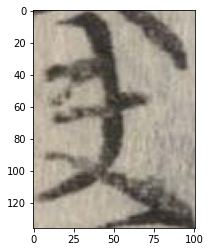

梅


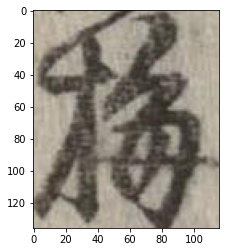

嬉


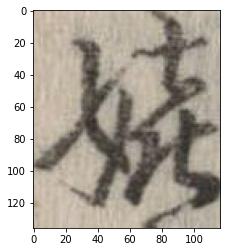

茶


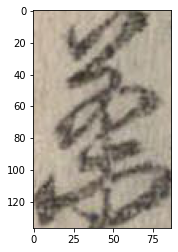

髪


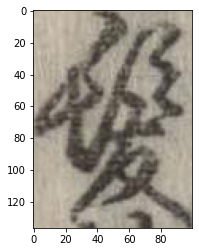

達


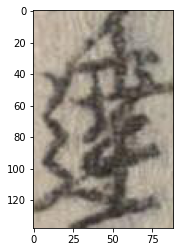

大


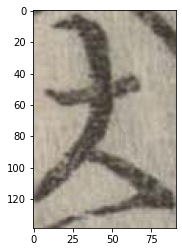

行


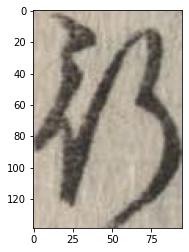

自


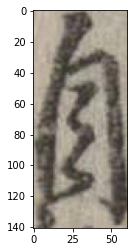

月


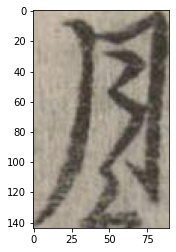

番


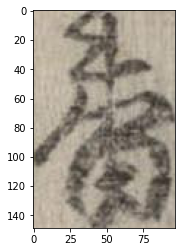

参


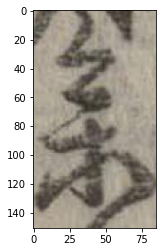

気


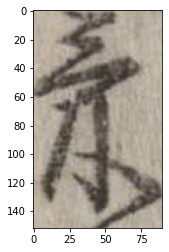

違


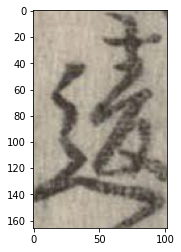

気


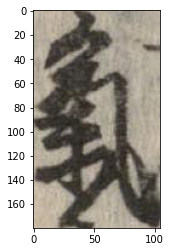

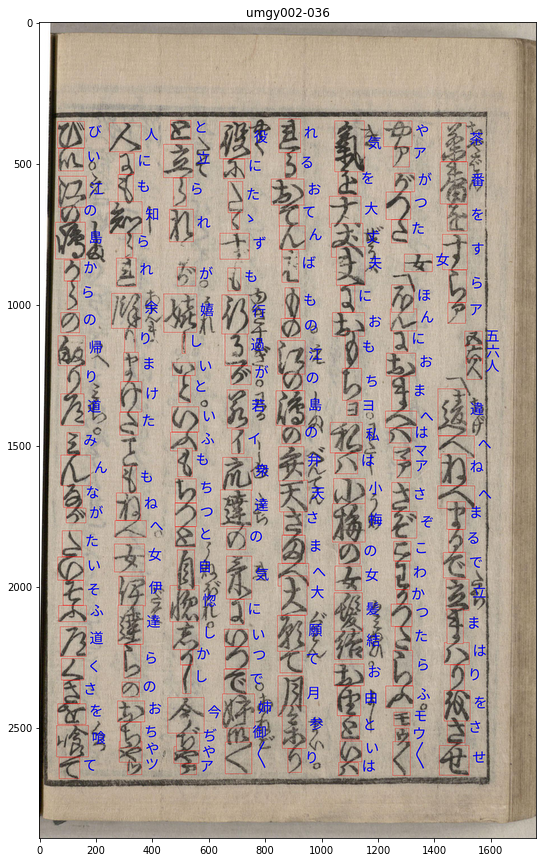

In [6]:
np.random.seed(1337)

for i in range(1):
    img, labels = df_train.values[np.random.randint(len(df_train))]
    viz = visualize_training_data('/content/drive/MyDrive/Train/Images/{}.jpg'.format(img), labels)
    
    plt.figure(figsize=(15, 15))
    plt.title(img)
    plt.imshow(viz, interpolation='lanczos')
    plt.show()

In [7]:
def preProcessImage(image):
    #image = np.asarray(image)
    #image = image.resize((300,300))
    #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret,th1 = cv2.threshold(image,155,255,cv2.THRESH_BINARY)
    return th1

In [8]:
# This function takes in a filename of an image, and the labels in the string format given in a submission csv, and returns an image with the characters and predictions annotated.
def Extract_Data():
    X_=[]
    y_=[]
    # Convert annotation string to array #300
    for img, labels in tqdm(df_train[:420].values):
        try:
            image_fn = '/content/drive/MyDrive/Train/Images/{}.jpg'.format(img)
            labels = np.array(labels.split(' ')).reshape(-1, 5)
            # Read image
            imsource = Image.open(image_fn).convert('RGBA')
            bbox_canvas = Image.new('RGBA', imsource.size)
            char_canvas = Image.new('RGBA', imsource.size)
            bbox_draw = ImageDraw.Draw(bbox_canvas) # Separate canvases for boxes and chars so a box doesn't cut off a character
            char_draw = ImageDraw.Draw(char_canvas)

            for codepoint, x, y, w, h in labels:
                x, y, w, h = int(x), int(y), int(w), int(h)
                char = unicode_map[codepoint] # Convert codepoint to actual unicode character

                # Draw bounding box around character, and unicode character next to it
                #bbox_draw.rectangle((x-10, y-10, x+10, y+10), fill=(255, 0, 0, 255))
                #char_draw.text((x+25, y-fontsize*(3/4)), char, fill=(255, 0, 0, 255), font=font)
                Croped_image = imsource.crop((x, y, x+w, y+h))
                image = Croped_image.resize((300,300))
                image = np.asarray(image)
                image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
                ret,th1 = cv2.threshold(image,155,255,cv2.THRESH_BINARY_INV)
                X_.append(th1)
                y_.append(str(unicode_map[codepoint]))
        except:
            pass
    X_ = np.array(X_)
    y_ = np.array(y_)

    '''imsource = Image.alpha_composite(Image.alpha_composite(imsource, bbox_canvas), char_canvas)
    imsource = imsource.convert("RGB") '''# Remove alpha for saving in jpg format.
    return X_,y_

In [9]:
XX_,yy_ = Extract_Data()

100%|██████████| 420/420 [02:58<00:00,  2.35it/s]


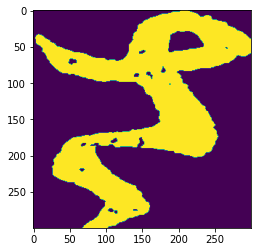

In [10]:
plt.figure()
plt.imshow(XX_[99])

In [11]:
XX_.shape

(51840, 300, 300)

In [12]:
unique, counts = np.unique(yy_, return_counts=True)
print(unique, counts )

['?' '▲' '○' ... '鼎' '鼻' '蓮'] [  1  54 198 ...   6   1   1]


In [13]:
NoOfClasses = len(unique)
NoOfClasses

1465

In [14]:
IMG_ROWS=300
IMG_COLS=300
def PreProcessData(X,y):
    lb = LabelEncoder()
    y_integer = lb.fit_transform(y)
    out_y = np_utils.to_categorical(y_integer)
    num_images = X.shape[0]
    out_x = X.reshape(num_images, IMG_ROWS, IMG_COLS, 1)
    #out_x = x_shaped_array / 255
    return out_x, out_y

In [15]:
lb = LabelEncoder()
y_integer = lb.fit_transform(yy_)

In [16]:
X,y = PreProcessData(XX_,yy_)

In [17]:
X_train, X_val, y_train, y_val = train_test_split(X, y, random_state=42)

In [18]:
K.clear_session()
def Kuzushiji_Classifier(in_):
    model_ = Conv2D(32,(3,3),activation='relu', padding="same")(in_)
    model_ = BatchNormalization()(model_)
    model_ =  Conv2D(32,(3, 3), activation='relu')(model_)
    model_ = BatchNormalization()(model_)
    model_ = Conv2D(32,5,strides=2,padding='same',activation='relu')(model_)
    model_ = MaxPooling2D((2, 2))(model_)
    model_ = BatchNormalization()(model_)
    model_ = Dropout(0.4)(model_)
    model_ = Conv2D(64,(3, 3), strides=2,padding='same', activation='relu')(model_)
    model_ = MaxPooling2D(pool_size=(2, 2))(model_)
    model_ = BatchNormalization()(model_)
    model_ = Conv2D(64, kernel_size=(3, 3), strides=2,padding='same', activation='relu')(model_)
    model_ = Dropout(0.4)(model_)
    model_ = Flatten()(model_)
    model_ = Dense(128, activation='relu')(model_)
    model_ = Dropout(0.4)(model_)
    model_ = Dense(NoOfClasses, activation='softmax')(model_)
    return model_

In [19]:
Input_Sample = Input(shape=(300, 300,1))
Output_ = Kuzushiji_Classifier(Input_Sample)
Model_Enhancer = Model(inputs=Input_Sample, outputs=Output_)

In [20]:
Model_Enhancer.compile(loss = "categorical_crossentropy", optimizer="adam", metrics=["accuracy"])
Model_Enhancer.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 300, 300, 1)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 300, 300, 32)      320       
_________________________________________________________________
batch_normalization (BatchNo (None, 300, 300, 32)      128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 298, 298, 32)      9248      
_________________________________________________________________
batch_normalization_1 (Batch (None, 298, 298, 32)      128       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 149, 149, 32)      25632     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 32)        0     

In [21]:
checkpointer = ModelCheckpoint('/content/drive/MyDrive/Train/model_Kuzushiji.h5', verbose=0,mode='auto', monitor='val_acc',save_best_only=True)

In [22]:
ModelHistory = Model_Enhancer.fit(X_train, y_train,
          batch_size=16,
          epochs=15,
          verbose=1,callbacks=[checkpointer],
          validation_data=(X_val, y_val))

Epoch 1/15
 296/2430 [==>...........................] - ETA: 3:32:09 - loss: 5.6806 - accuracy: 0.1093

KeyboardInterrupt: ignored

In [24]:
Model_ = load_model('/content/drive/MyDrive/Train/model_Kuzushiji.h5')

In [25]:
def VisualizeKuzushiji(imagePath):
    img = cv2.imread(imagePath)
    imsource = Image.open(imagePath)#fromarray(img)
    char_draw = ImageDraw.Draw(imsource)
    im_grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, im_th = cv2.threshold(im_grey, 130, 255, cv2.THRESH_BINARY_INV)
    ctrs,_ = cv2.findContours(im_th.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    rects = [cv2.boundingRect(ctr) for ctr in ctrs]
    Kuzushijis = []
    for rect in rects:
        leng = int(rect[3] * 1.6)
        pt1 = int(rect[1] + rect[3]//2 - leng// 2)
        pt2 = int(rect[0] + rect[2]//2 - leng// 2)
        roi = im_th[pt1:pt1+leng, pt2:pt2+leng]
        #bbox_draw.rectangle((rect[0], rect[1], rect[0] + rect[2],rect[1] + rect[3]), fill=(0, 225, 0, 0))
        #print(roi.size)
        if roi.size>7000:
            cv2.rectangle(img, (rect[0], rect[1]), (rect[0] + rect[2], rect[1] + rect[3]), (225, 0, 0), 6)
            roi = cv2.resize(roi, (300,300))
            #roi = cv2.dilate(roi, (3, 3))
            ret,th1 = cv2.threshold(roi,155,255,cv2.THRESH_BINARY)
            ProcessImage = th1.reshape(1,IMG_ROWS, IMG_COLS, 1)
            y_pred = Model_.predict(ProcessImage)
            y_true = np.argmax(y_pred,axis=1)
            Kuzushiji = lb.inverse_transform(y_true)
            #print(Kuzushiji[0])
            Kuzushijis.append(str(Kuzushiji[0]))
            char_draw.text((rect[0]+10, rect[1]),str(Kuzushiji[0]), fill=(0,22,225,0), font=font)
            #cv2.putText(img, str(Kuzushiji[0]), (rect[0], rect[1]),font, 2, (0, 255, 255), 3)
    return img,imsource

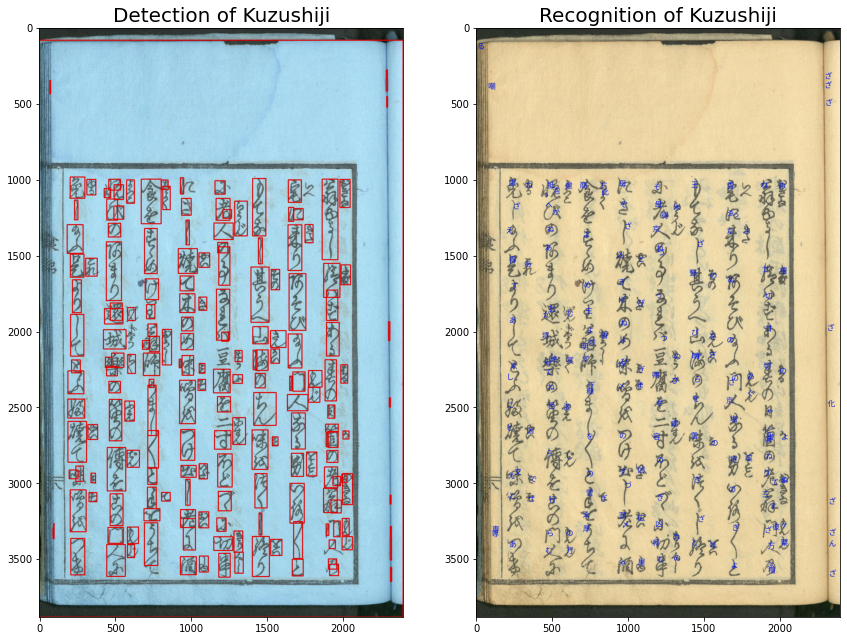

In [29]:
img1, imsource1 = VisualizeKuzushiji('/content/drive/MyDrive/Train/Images/100241706_00014_2.jpg')
plt.figure(figsize=(30,30))
plt.subplot(1,4,1)
plt.title("Detection of Kuzushiji",fontsize=20)
plt.imshow(img1)
plt.subplot(1,4,2)
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource1)

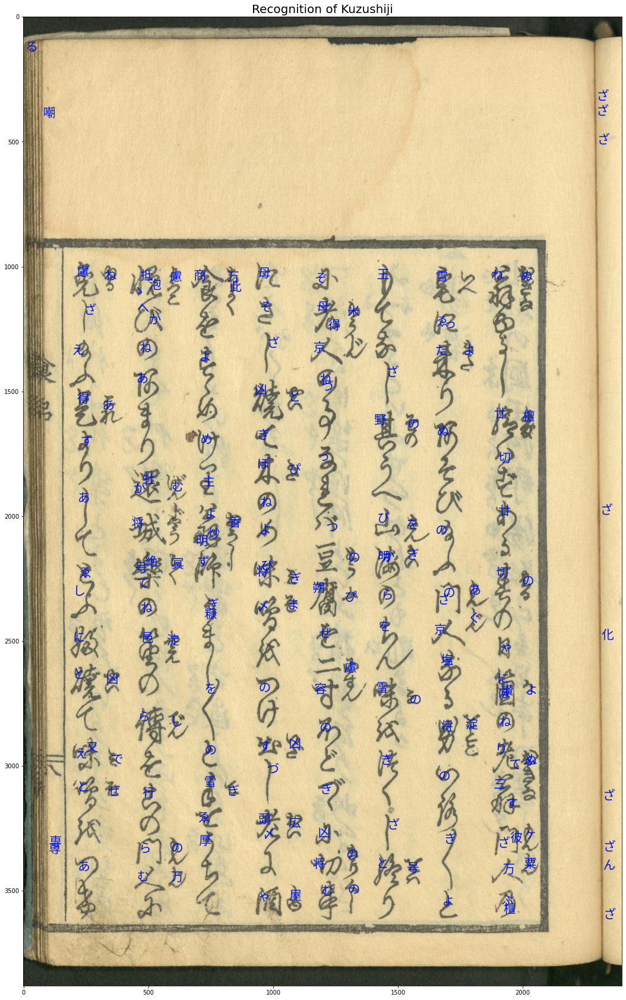

In [27]:
plt.figure(figsize=(30,30))
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource1)

In [31]:
!unzip /content/drive/MyDrive/Train/test_images.zip -d /content/drive/MyDrive/Train/Images_test

Archive:  /content/drive/MyDrive/Train/test_images.zip
  inflating: /content/drive/MyDrive/Train/Images_test/test_52763334.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_b95b102a.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_d945b780.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_bc072a9e.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_a927d18b.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_87a6815b.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_512c1837.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_e5fa90e7.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_9e69b7fe.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_e2d7cb1c.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_3365918e.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/test_a41fe924.jpg  
  inflating: /content/drive/MyDrive/Train/Images_test/tes

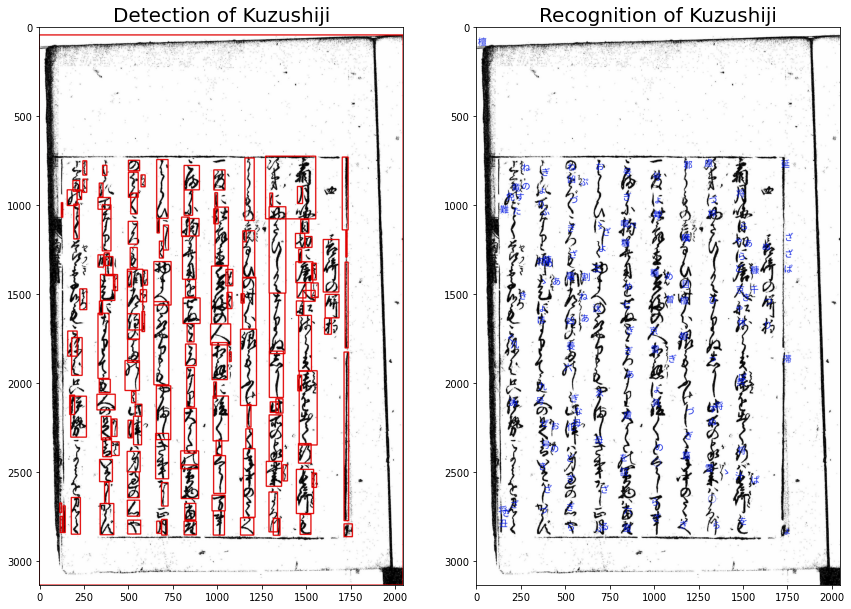

In [33]:
img2, imsource2 = VisualizeKuzushiji('/content/drive/MyDrive/Train/Images_test/test_001c37e2.jpg')
plt.figure(figsize=(30,30))
plt.subplot(1,4,1)
plt.title("Detection of Kuzushiji",fontsize=20)
plt.imshow(img2)
plt.subplot(1,4,2)
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource2)

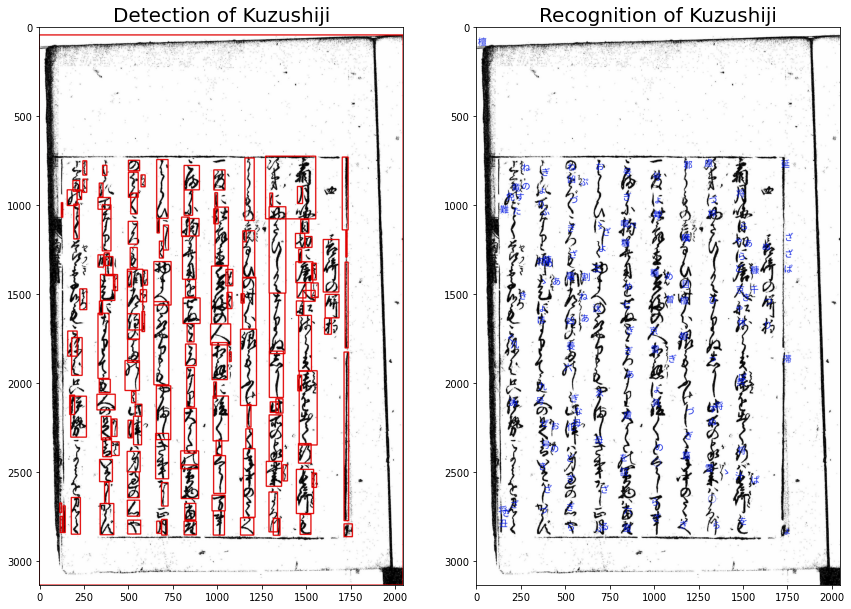

In [38]:
img3, imsource3 = VisualizeKuzushiji('/content/drive/MyDrive/Train/Images_test/test_001c37e2.jpg')
plt.figure(figsize=(30,30))
plt.subplot(1,4,1)
plt.title("Detection of Kuzushiji",fontsize=20)
plt.imshow(img3)
plt.subplot(1,4,2)
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource3)

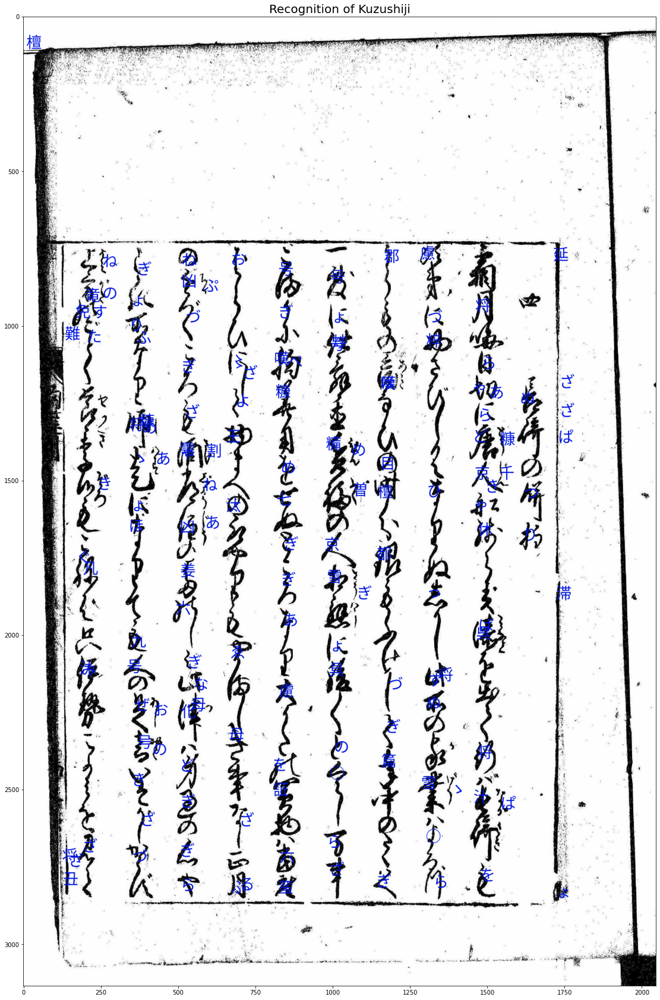

In [39]:
plt.figure(figsize=(30,30))
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource3)

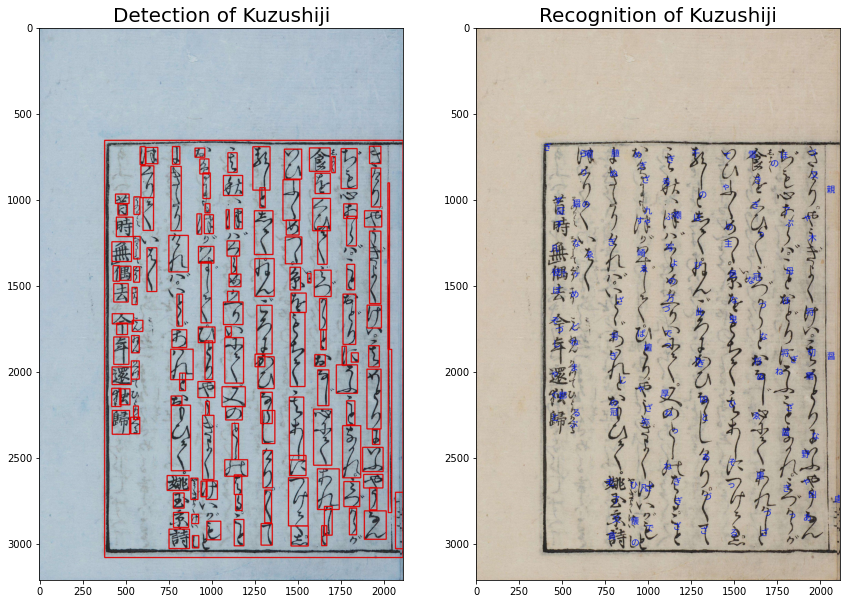

In [40]:
img4, imsource4 = VisualizeKuzushiji('/content/drive/MyDrive/Train/Images_test/test_1abdbbfe.jpg')
plt.figure(figsize=(30,30))
plt.subplot(1,4,1)
plt.title("Detection of Kuzushiji",fontsize=20)
plt.imshow(img4)
plt.subplot(1,4,2)
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource4)

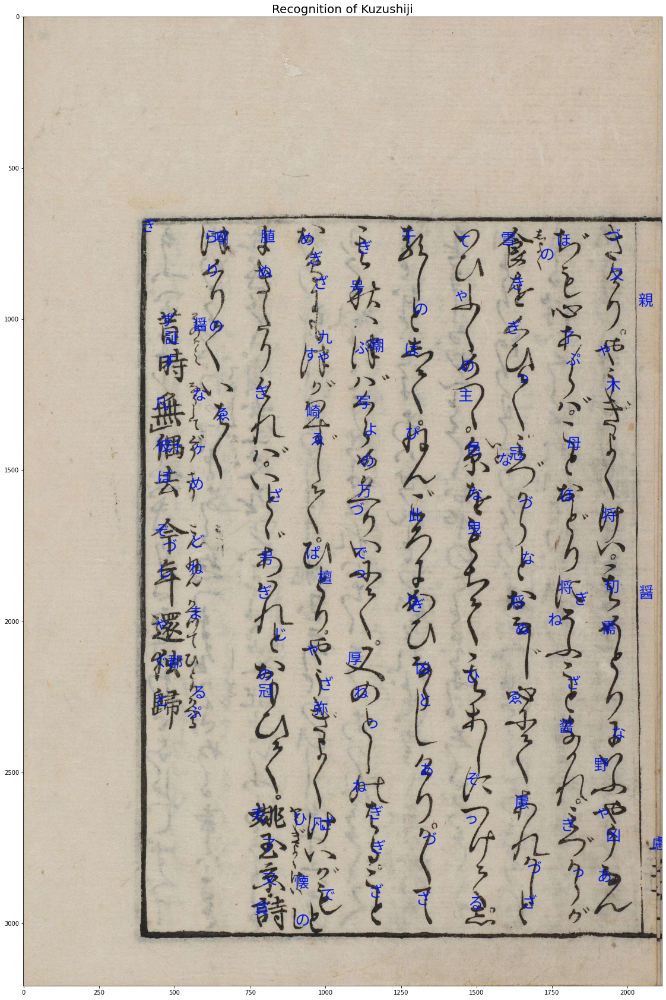

In [41]:
plt.figure(figsize=(30,30))
plt.title("Recognition of Kuzushiji",fontsize=20)
plt.imshow(imsource4)